### TikTok

In [ ]:
#The following script is adapted from the Geeks for Geeks “BeautifulSoup – Scraping Link from HTML” tutorial: https://www.geeksforgeeks.org/beautifulsoup-scraping-link-from-html/![image-3.png](attachment:image-3.png)

In [ ]:
url_to_scrape = "https://www.tiktok.com/community-guidelines/en/safety-civility/"

In [ ]:
#call the function to retrieve HTML document
html_document = getHTMLdocument(url_to_scrape)

In [ ]:
# use BeautifulSoup to parse the HTML document
soup = BeautifulSoup(html_document, 'html.parser')

In [ ]:
# find all the anchor tags with "href" attribute starting with "https://"
for link in soup.find_all('a', attrs={'href': re.compile("^https://")}):
    # display the actual urls
    print(link.get('href')) 

In [7]:
# The following script is adapted from (Krisel, 2023) https://github.com/intro-to-text-analysis-SIPA-S23/syllabus

In [207]:
# read CSV file containing URLs to scrape
data_df= pd.read_csv("TikTok Community Guidelines URLs - Sheet1.csv", delimiter=',', encoding='utf-8')

In [208]:
# create a DataFrame with the URLs to scrape
TikTok_urls = data_df

In [209]:
# define function to scrape article from URL
def scrape_article(URL):
    response = requests.get(URL)
    response.encoding = 'utf-8'
    html_string = response.text
    return html_string

In [210]:
# apply the 'scrape_article' function to each URL in the DataFrame and store the resulting HTML in a new column 'text'
TikTok_urls['text'] = TikTok_urls['URL'].apply(scrape_article)

In [211]:
# display the DataFrame with the scraped HTML
TikTok_urls

,Platform,URL,text
0,TikTok,https://www.tiktok.com/,"<!DOCTYPE html><html lang=""en"" data-theme=""lig..."
1,TikTok,https://scsanctions.un.org/k8946en-all.html,"<!DOCTYPE html>\r\n<html lang=""en"">\r\n<head>\..."
2,TikTok,https://www.missingkids.org/HOME,"\n\n<!doctype html>\n<html lang=""en"">\n\n<head..."
3,TikTok,https://www.tiktok.com/safety/sexual-assault-r...,"<!doctype html>\n <html lang=""en-US"" dir=""l..."
4,TikTok,https://www.tiktok.com/safety/prevent-csam/,"<!doctype html>\n <html lang=""en-US"" dir=""l..."
5,TikTok,https://inhope.org/EN/articles/what-is-self-ge...,"<!doctype html>\n<html lang="""">\n<head>\n <!-..."
6,TikTok,https://www.tiktok.com/community-guidelines/en...,"<!doctype html>\n <html lang=""en"" dir=""ltr""..."
7,TikTok,https://www.tiktok.com/safety/sexual-assault-r...,"<!doctype html>\n <html lang=""en-US"" dir=""l..."
8,TikTok,https://www.tiktok.com/legal/report/privacy?la...,"<!DOCTYPE html><html lang=""en"" pc=""yes"">\n ..."
9,TikTok,https://www.tiktok.com/safety/bullying-prevent...,"<!doctype html>\n <html lang=""en-US"" dir=""l..."


<!DOCTYPE html><html lang="en" data-theme="light"><head><meta charSet="UTF-8"/><style data-emotion="tiktok "></style><title data-rh="true">TikTok - Make Your Day</title><meta data-rh="true" name="google" content="notranslate"/><meta data-rh="true" name="format-detection" content="telephone=no"/><meta data-rh="true" name="keywords" content="TikTok, TikTok, musically, mobile video, short-form video,tik tok, tick tock, tic tok, tic toc, tictok, тик ток, ticktock"/><meta data-rh="true" name="description" content="TikTok - trends start here. On a device or on the web, viewers can watch and discover millions of personalized short videos. Download the app to get started."/><meta data-rh="true" name="robots" content="index, follow"/><meta data-rh="true" name="applicable-device" content="pc, mobile"/><meta data-rh="true" property="og:image" content="https://sf-tb-sg.ibytedtos.com/obj/eden-sg/uhtyvueh7nulogpoguhm/tiktok-icon2.png"/><meta data-rh="true" property="twitter:image" content="https://s
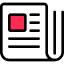
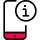
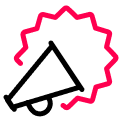
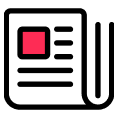
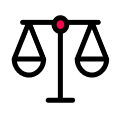
...
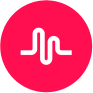
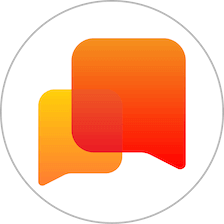
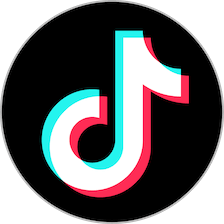
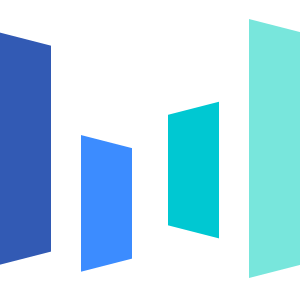
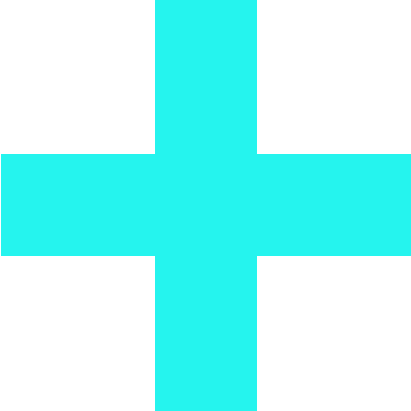

In [212]:
# print the text of each article
for text in TikTok_urls['text']:
    print(text)

In [213]:
# save the text of each article to a text file
with open("all_articles_TikTok.txt","w") as file:
    for text in TikTok_urls['text']:
        soup = BeautifulSoup(text)
        article = soup.get_text()
        file.write(article)

In [214]:
# create a directory to store the cleaned text files
! mkdir files_tiktok

mkdir: files_tiktok: File exists


In [215]:
# iterate over each article, remove HTML tags, and save the cleaned text to a separate file in the 'files' directory
import os
id = 0
for text in TikTok_urls['text']:
    soup = BeautifulSoup(text)
    article = soup.get_text()

    id += 1
    file_path = f"files_tiktok/article_{id}.txt"
    os.makedirs(os.path.dirname(file_path), exist_ok=True)
    with open(file_path, "w") as file:
        file.write(str(article))

In [216]:
! cd files_tiktok
! ls files_tiktok

article_1.txt  article_16.txt article_22.txt article_29.txt article_35.txt
article_10.txt article_17.txt article_23.txt article_3.txt  article_4.txt
article_11.txt article_18.txt article_24.txt article_30.txt article_5.txt
article_12.txt article_19.txt article_25.txt article_31.txt article_6.txt
article_13.txt article_2.txt  article_26.txt article_32.txt article_7.txt
article_14.txt article_20.txt article_27.txt article_33.txt article_8.txt
article_15.txt article_21.txt article_28.txt article_34.txt article_9.txt


In [217]:
! cd ..

In [219]:
# Create a function to derive the Part of Speech (POS) of given words. 
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)

In [220]:
#combining the text files into one file
import glob

files = glob.glob("files_tiktok/*.txt")
combined_text = ""

for file in files:
    with open(file, encoding='utf-8') as f:
        text = f.read()
        combined_text += text + "\n"

with open("CommunityGuidelines_tiktok.txt", "w", encoding='utf-8') as f:
    f.write(combined_text)